# SPACEc: Clustering

After preprocessing the single cell data, the next step is to assign cell types. One of the most common approaches to identify cell types is unsupervised or semi-unsupervised clustering. scCODEX utilizes the widely used scanpy library to carry out this task. The user can specify different clustering resolutions as well as the number of nearest neighbors to modify the number of identified clusters. The flexible design of scCODEX allows for the selection of unique clustering strategies, dependent on the research question and available dataset. 

If you work with very large datasets consider using the GPU accelerated leiden clustering. Check our GitHub page for installation instructions.

This notebook utilizes the scanpy library for clustering and visualization.

In [1]:
# import spacec first
import spacec as sp

#import standard packages
import os
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt

# silencing warnings
import warnings
warnings.filterwarnings('ignore')

plt.rc('axes', grid=False)  # remove gridlines
sc.settings.set_figure_params(dpi=80, facecolor='white') # set dpi and background color for scanpy figures

INFO:root: * TissUUmaps version: 3.1.1.6
/home/tim/miniforge3/envs/spacec/lib/python3.9/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/tim/miniforge3/envs/spacec/lib/python3.9/site-packages/cudf/utils/gpu_utils.py:89: UserWarning: A GPU with NVIDIA Volta™ (Compute Capability 7.0) or newer architecture is required.
Detected GPU 0: NVIDIA GeForce GTX 1070                                                                                                                                                                                                                                         
Detected Compute Capability: 6.1
  warnings.warn(


In [2]:
# Specify the path to the data
root_path = "/home/user/path/SPACEc/" # inset your own path
data_path = root_path + 'example_data/raw/' # where the data is stored

# where you want to store the output
output_dir = root_path + 'example_data/output/'
os.makedirs(output_dir, exist_ok=True)

In [4]:
# Loading the denoise/filtered anndata from notebook 2
adata = sc.read(output_dir + 'adata_nn_demo.h5ad')
adata # check the adata

AnnData object with n_obs × n_vars = 51138 × 58
    obs: 'DAPI', 'x', 'y', 'area', 'region_num', 'unique_region', 'condition'

## Clustering

By setting a  clustering seed you can ensure that your PC is always performing clustering in the same way. This is important if you want to change or correct things later on.

In [6]:
clustering_random_seed = 0

Before you start to annotate your cells try to develop a clustering strategy. Common approaches include to start with a coarse annotation such as immune cell, tumor cell, etc. and then refine the clusters. Another common strategy is to overcluster your dataset and then remerge split populations. Depending on your dataset you will often find yourself to use a mixed approach. Best practice is to start clustering with a set of markers that best describes your cell types. Functional markers such as PD1 should therefore be used later if you refine your clusters. 
In this simple example we will start with a fairly large collection of markers and employ several rounds of subclustering to improve the results over multiple iterations. 

In [17]:
# This step can be long if you have large phenocycler images

# Use this cell-type specific markers for cell type annotation
marker_list = [
    'FoxP3', 'HLA-DR', 'EGFR', 'CD206', 'BCL2', 'panCK', 'CD11b', 'CD56', 'CD163', 'CD21', 'CD8', 
    'Vimentin', 'CCR7', 'CD57', 'CD34', 'CD31', 'CXCR5', 'CD3', 'CD38', 'LAG3', 'CD25', 'CD16', 'CLEC9A', 'CD11c', 
    'CD68', 'aSMA', 'CD20', 'CD4','Podoplanin', 'CD15', 'betaCatenin', 'PAX5', 
    'MCT', 'CD138', 'GranzymeB', 'IDO-1', 'CD45', 'CollagenIV', 'Arginase-1']

# clustering
adata = sp.tl.clustering(
    adata, 
    clustering='leiden', # can choose between leiden and louvian
    n_neighbors=10, # number of neighbors for the knn graph
    resolution = 1, #clustering resolution (higher resolution gives more clusters)
    reclustering = False, # if true, no computing the neighbors
    marker_list = marker_list, #if it is None, all variable names are used for clustering
    seed=clustering_random_seed, # random seed for clustering - reproducibility
)

Computing neighbors and UMAP
Clustering
Leiden clustering


Visualizing your results as UMAP scatter plot helps to identify batch effects and to estimate how well clusters are separated. What we want to see is poor separation between the regions (left) and good separation between the clusters (right). 

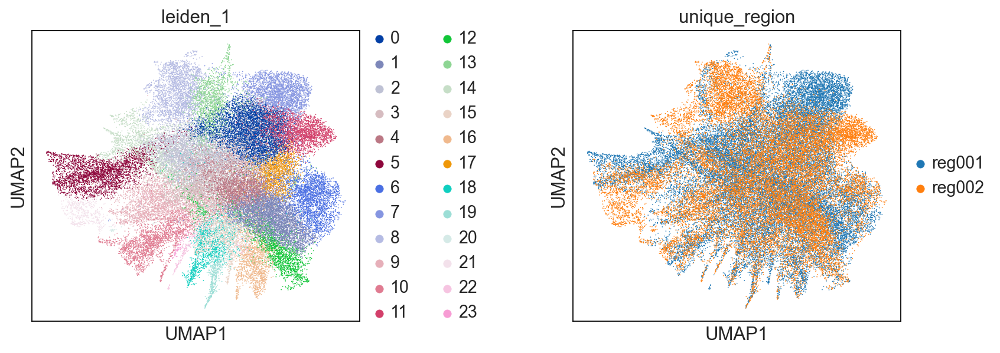

In [21]:
# visualization of clustering with UMAP
sc.pl.umap(adata, color = ['leiden_1', 'unique_region'], wspace=0.5) 

This plot shows the marker expression profile per cluster and helps to identify clusters that need subclustering. Subclustering splits a cluster into a number of subclusters, to enhance clustering resolution for this specific subset of cells.

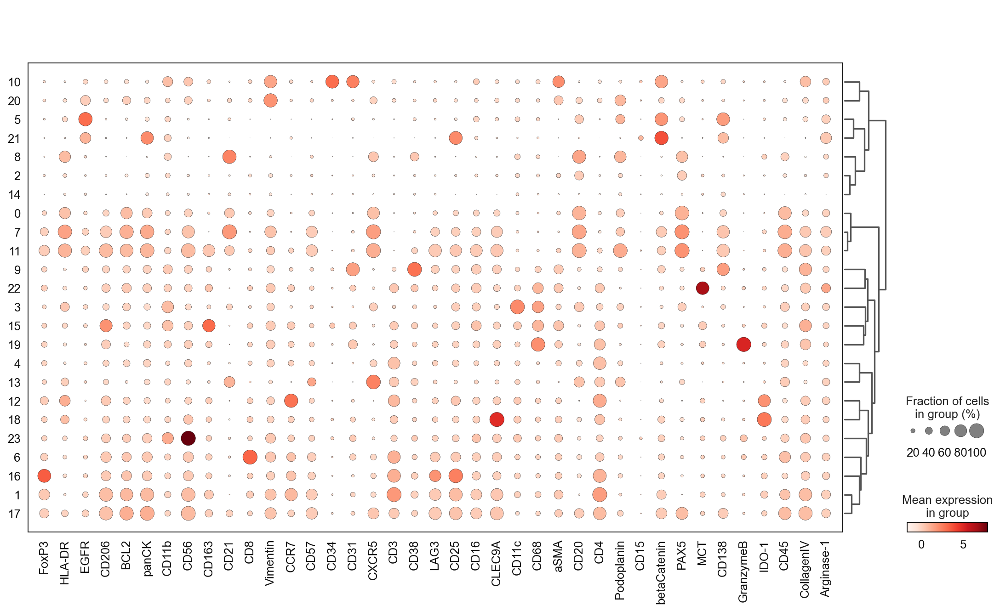

In [28]:
sc.pl.dotplot(adata, 
              marker_list, # The list of markers to show on the x-axis
              'leiden_1', # The cluster column
              dendrogram = True) # Show the dendrogram

### Subclustering round 1

In [49]:
# subclustering cluster 0, 3, 4 sequentially (could be optional for your own data)
sc.tl.leiden(adata, 
             seed=clustering_random_seed, # random seed for clustering - reproducibility
             restrict_to=('leiden_1',['0']), # select the cluster column name (your previously generated key) and the cluster name you want to subcluster
             resolution=0.3, # resolution for subclustering
             key_added='leiden_1_subcluster') # key added to adata.obs (keep it the same to avoid confusion and limit the adata object size)

# repeat the same for other clusters you want to subcluster
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['1']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['3']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['7']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['11']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['12']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['14']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['16']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['17']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['20']), resolution=0.3, key_added='leiden_1_subcluster')

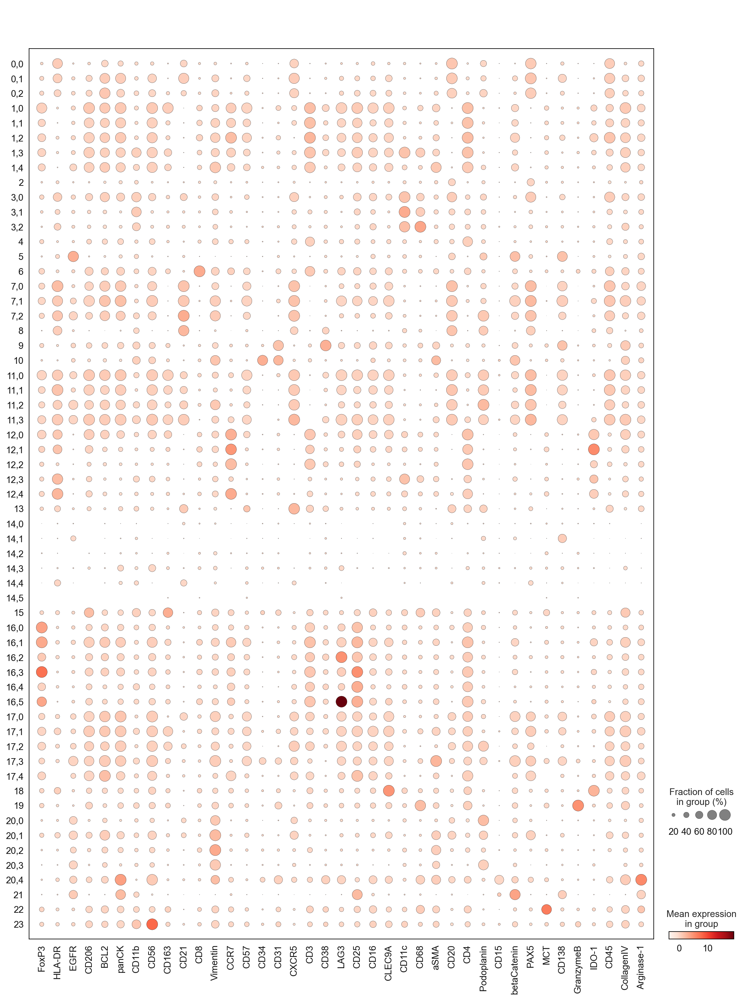

In [50]:
# Visualize cluster expression profiles 
sc.pl.dotplot(adata, 
              marker_list, 
              'leiden_1_subcluster', # The cluster column (now use the subcluster column)
              dendrogram = False)

Once you feel ready for the first round of annotation you can generate a dictionary to rename each cluster with an according biological name. Be aware that dense regions sometimes lead to spillover. This spillover can only be corrected to a certain degree and often leads to cells being slightly positive for the markers of neighboring cells. The best practice for precise annotation is to inspect the spatial position of the annotated cells. This can either be done through the catplot function or via the TissUUmaps module.

If you are not sure about a cluster and need further subclustering to resolve mixed populations give these clusters a placeholder name such as recluster. 

In [51]:
# tentative annotation based on the marker 
cluster_to_ct_dict = {
    '0,0': 'B cell', 
    '0,1': 'recluster', 
    '0,2': 'B cell', 
    '1,0': 'recluster',
    '1,1': 'recluster',
    '1,2': 'recluster',
    '1,3': 'recluster',
    '1,4': 'recluster',
    '2': 'B cell', 
    '3,0': 'DC', 
    '3,1': 'DC', 
    '3,2': 'M1 Macrophage', 
    '4': 'CD4+ T cell', 
    '5': 'Epithelial cell',
    '6': 'CD8+ T cell',
    '7,0': 'B cell',
    '7,1': 'recluster',
    '7,2': 'B cell',
    '8': 'GCB',
    '9': 'Plasma cell',
    '10': 'Vessel',
    '11,0': 'B cell',  
    '11,1': 'B cell',  
    '11,2': 'B cell',  
    '11,3': 'B cell',  
    '12,0': 'CD4+ T cell',
    '12,1': 'CD4+ T cell',
    '12,2': 'CD4+ T cell',
    '12,3': 'DC',
    '12,4': 'DC',
    '13': 'B cell',
    '14,0': 'Noise',
    '14,1': 'Noise',
    '14,2': 'Noise',
    '14,3': 'Noise',
    '14,4': 'Noise',
    '14,5': 'Noise',
    '15': 'M2 Macrophage',
    '16,0': 'Treg',
    '16,1': 'Treg',
    '16,2': 'CD4+ T cell',
    '16,3': 'Treg',
    '16,4': 'CD4+ T cell',
    '16,5': 'Treg',
    '17,0': 'recluster',
    '17,1': 'recluster',
    '17,2': 'recluster',
    '17,3': 'recluster',
    '17,4': 'recluster',
    '18': 'cDC1',
    '19': 'M1 Macrophage',
    '20,0': 'Epithelial cell',
    '20,1': 'Epithelial cell',
    '20,2': 'Epithelial cell',
    '20,3': 'Epithelial cell',
    '20,4': 'recluster',
    '21': 'Epithelial cell',
    '22': 'Mast cell',
    '23': 'NK cell',
}

# This allows us to generate a new column named cell_type_coarse based on the leiden_1_subcluster column
adata.obs['cell_type_coarse'] = ( # create a new column
    adata.obs['leiden_1_subcluster'] # get the cluster names
    .map(cluster_to_ct_dict) # map the cluster names to cell types
    .astype('category') # convert to category
)

### First QC

After the first round of annotation you should check your results.

1) Make sure that each cell type expresses the correct markers.
2) Check the spatial position of cell types (consider speaking to a domain expert if you are unsure about the tissue)
3) Check the frequencies of cells - do these numbers fit with the biology of your sample?

Try to take your time and evaluate each step carefully to achieve the best results. 

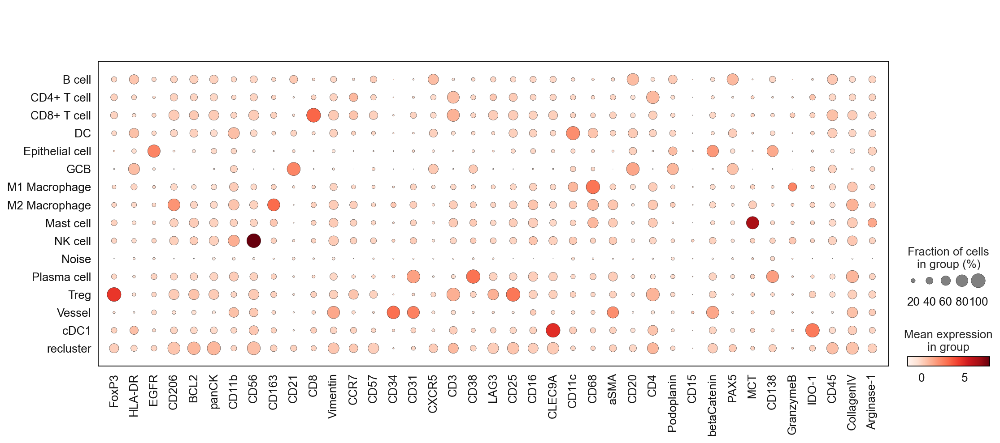

In [52]:
# Check the marker expression of the annotated cell types
sc.pl.dotplot(adata, marker_list, 'cell_type_coarse', dendrogram = False)

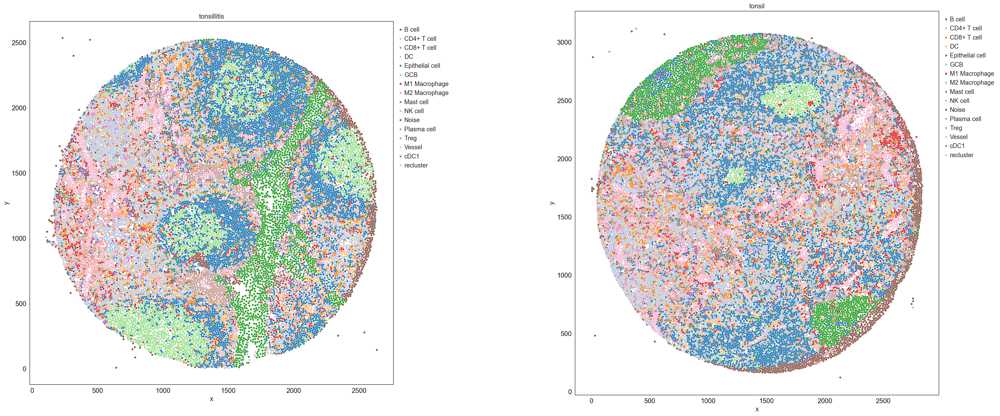

In [53]:
sp.pl.catplot(
    adata, 
    color = "cell_type_coarse", # specify group column name here (e.g. celltype_fine)
    unique_region = "condition", # specify unique_regions here
    X='x', Y='y', # specify x and y columns here
    n_columns=2, # adjust the number of columns for plotting here (how many plots do you want in one row?)
    palette='tab20', #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=False, # save figure as pdf
    output_fname = "", # change it to file name you prefer when saving the figure
    output_dir=output_dir, # specify output directory here (if savefig=True)
    figsize= 17, # specify the figure size here
    size = 20) # specify the size of the points

In [54]:
# print the frequencies of cell types
adata.obs['cell_type_coarse'].value_counts()

cell_type_coarse
B cell             12473
recluster           8345
CD4+ T cell         5401
Epithelial cell     3922
DC                  2858
CD8+ T cell         2715
GCB                 2512
Plasma cell         2330
Vessel              2298
M1 Macrophage       2042
Noise               1783
M2 Macrophage       1727
Treg                1195
cDC1                1048
Mast cell            354
NK cell              135
Name: count, dtype: int64

### subclustering round 2

Repeat the previously conducted procedure. It might be necessary to do this multiple times, dependent on the size and complexity of your dataset as well as your staining quality.

In [55]:
sc.tl.leiden(adata, 
             seed=clustering_random_seed, 
             restrict_to=('cell_type_coarse',['recluster']), # select the cluster column name (your previously generated key) and the cluster name you want to subcluster
             resolution=1.5,
             key_added='cell_type_coarse_subcluster') # new column added to adata.obs

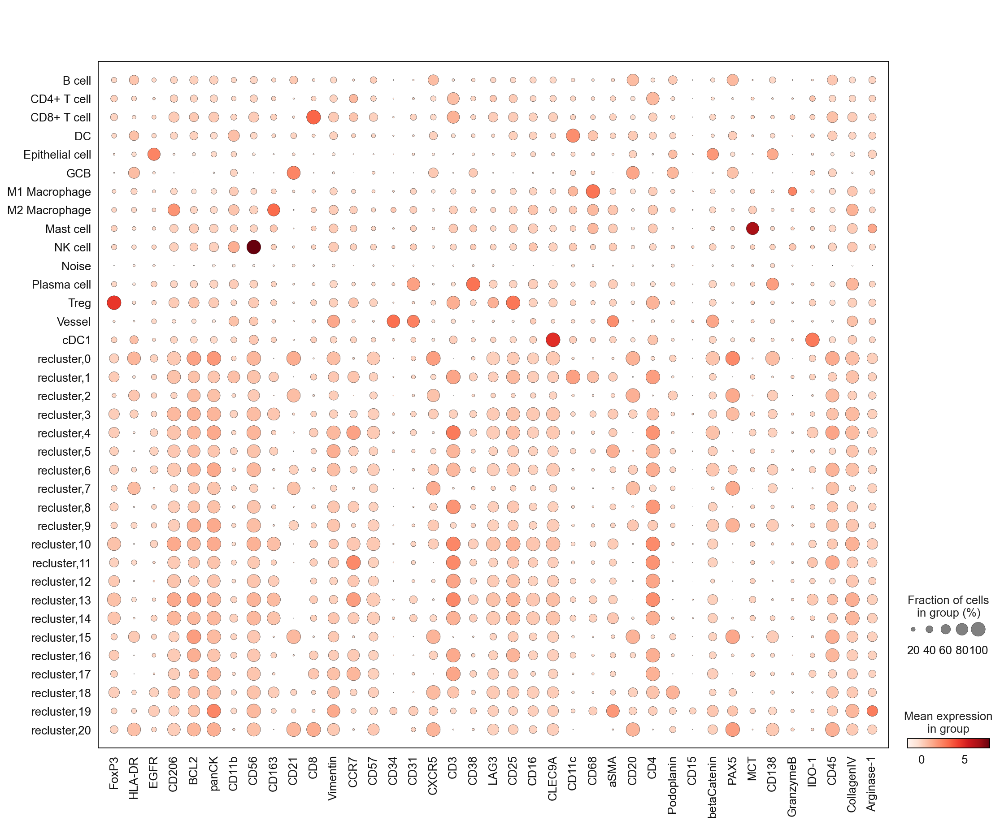

In [57]:
sc.pl.dotplot(adata, marker_list, 'cell_type_coarse_subcluster', dendrogram = False)

In [73]:
# tentative annotation based on the marker 
cluster_to_ct_dict = {
    'B cell': 'B cell', 
    'CD4+ T cell': 'CD4+ T cell', 
    'CD8+ T cell': 'CD8+ T cell', 
    'DC': 'DC', 
    'Epithelial cell': 'Epithelial cell', 
    'GCB': 'GCB', 
    'M1 Macrophage': 'M1 Macrophage', 
    'M2 Macrophage': 'M2 Macrophage', 
    'Mast cell': 'Mast cell', 
    'NK cell': 'NK cell',
    'Neutrophil': 'Neutrophil',
    'Treg': 'Treg',
    'Vessel': 'Vessel',
    'cDC1': 'cDC1',
    'Plasma cell': 'Plasma cell',
    'Noise': 'Noise',
    'recluster,0': 'B cell',
    'recluster,1': 'DC',
    'recluster,2': 'B cell',
    'recluster,3': 'recluster',
    'recluster,4': 'CD4+ T cell',
    'recluster,5': 'recluster',
    'recluster,6': 'recluster',
    'recluster,7': 'recluster',
    'recluster,8': 'CD4+ T cell',
    'recluster,9': 'recluster',
    'recluster,10': 'CD4+ T cell',
    'recluster,11': 'CD4+ T cell',
    'recluster,12': 'CD4+ T cell',
    'recluster,13': 'CD4+ T cell',
    'recluster,14': 'CD4+ T cell',
    'recluster,15': 'B cell',
    'recluster,16': 'CD4+ T cell',
    'recluster,17': 'CD4+ T cell',
    'recluster,18': 'recluster',
    'recluster,19': 'Epithelial cell',
    'recluster,20': 'B cell',
}

adata.obs['cell_type_coarse_f'] = (
    adata.obs['cell_type_coarse_subcluster']
    .map(cluster_to_ct_dict)
    .astype('category')
)

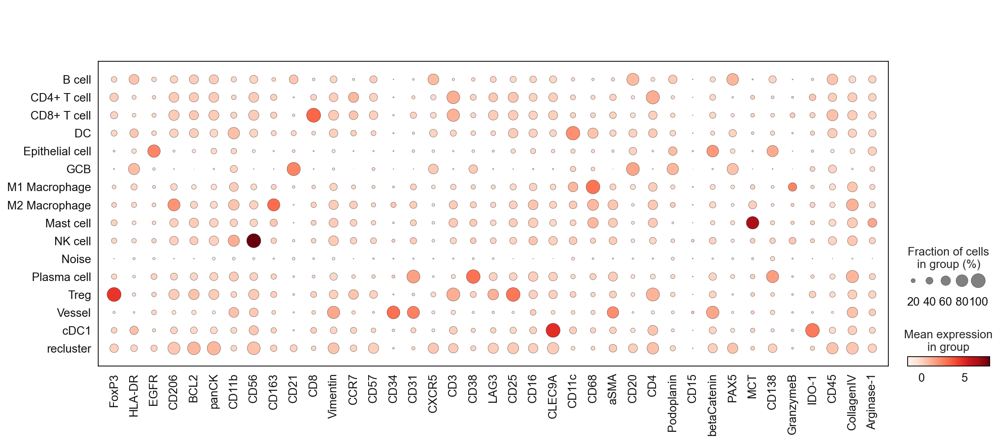

In [75]:
sc.pl.dotplot(adata, marker_list, 'cell_type_coarse_f', dendrogram = False)

In [76]:
# print the frequencies of cell types
adata.obs['cell_type_coarse_f'].value_counts()

cell_type_coarse_f
B cell             14304
CD4+ T cell         8655
Epithelial cell     3979
DC                  3500
CD8+ T cell         2715
recluster           2561
GCB                 2512
Plasma cell         2330
Vessel              2298
M1 Macrophage       2042
Noise               1783
M2 Macrophage       1727
Treg                1195
cDC1                1048
Mast cell            354
NK cell              135
Name: count, dtype: int64

If you encounter a cell population that seems to be impossible to annotate you can carefully check if your cells resemble noise or a segmentation artefact. In our example dataset, we encountered an edge effect during segmentation. Therefore, it is save to remove the cells labeled as noise. Please evaluate every case carefully, never drop cells if you are not sure that these are picked up by mistake. 

In [78]:
# remove noise 
adata = adata[~adata.obs['cell_type_coarse_f'].isin(['Noise'])]

### subclustering round 3

Repeat the previous steps... 

In [79]:
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('cell_type_coarse_f',['recluster']), resolution=1.5, key_added='cell_type_coarse_f_subcluster')

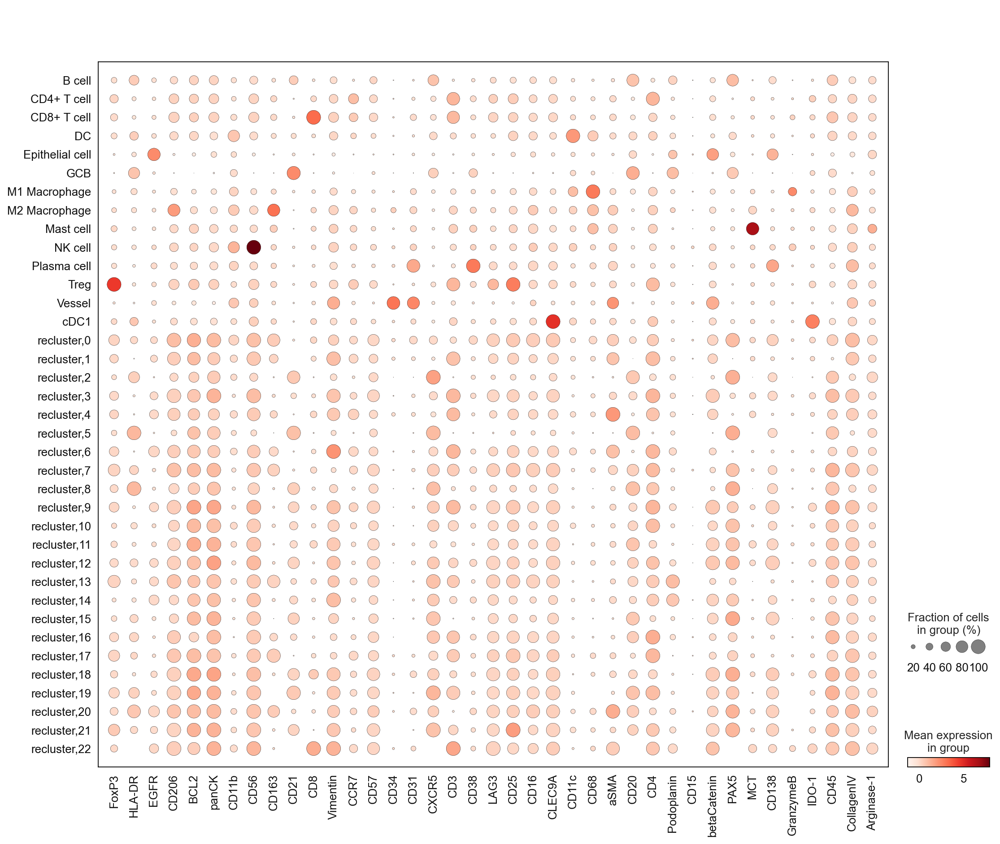

In [81]:
sc.pl.dotplot(adata, marker_list, 'cell_type_coarse_f_subcluster', dendrogram = False)

Scaling your data can help to boost contrast and allows to decide for difficult to annotate clusters.

In [ ]:
# scale and store results in layer
adata.layers["scaled"] = sc.pp.scale(adata, copy=True).X

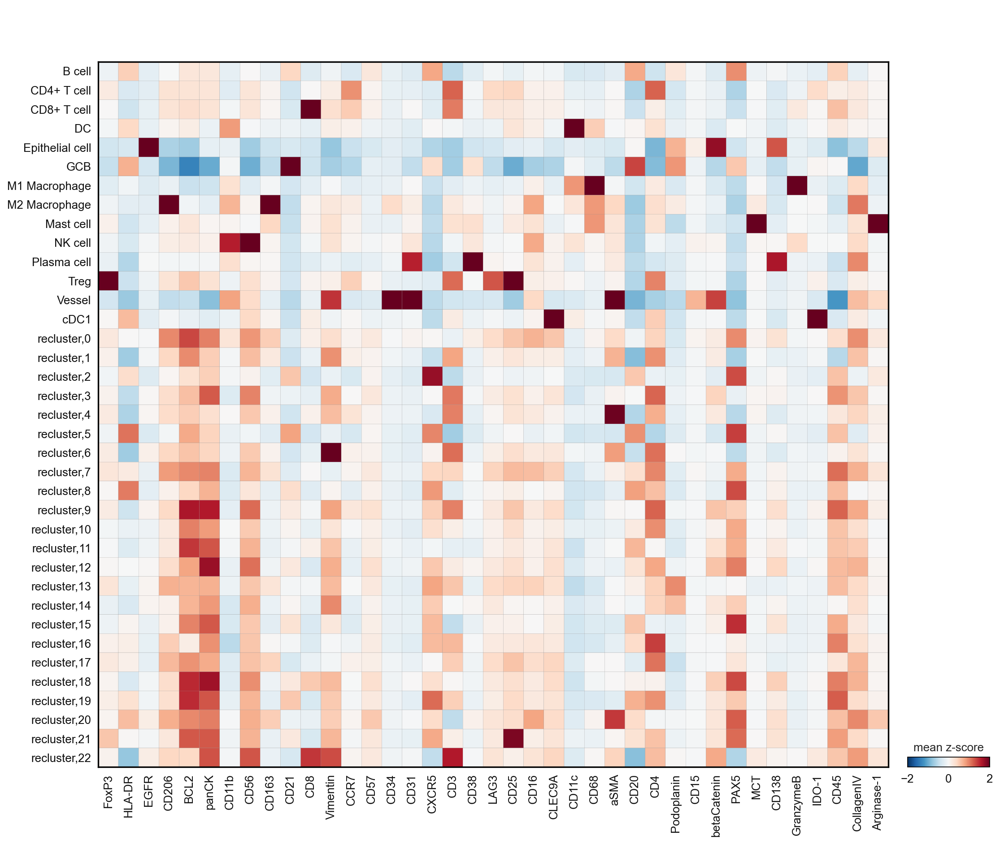

In [82]:
sc.pl.matrixplot(
    adata,
    marker_list,
    "cell_type_coarse_f_subcluster",
    dendrogram=False,
    colorbar_title="mean z-score",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
)

In [88]:
# tentative annotation based on the marker 
cluster_to_ct_dict = {
    'B cell': 'B cell', 
    'CD4+ T cell': 'CD4+ T cell', 
    'CD8+ T cell': 'CD8+ T cell', 
    'DC': 'DC', 
    'Epithelial cell': 'Epithelial cell', 
    'GCB': 'GCB', 
    'M1 Macrophage': 'M1 Macrophage', 
    'M2 Macrophage': 'M2 Macrophage', 
    'Mast cell': 'Mast cell', 
    'NK cell': 'NK cell',
    'Neutrophil': 'Neutrophil',
    'PMN': 'PMN',
    'Treg': 'Treg',
    'Vessel': 'Vessel',
    'cDC1': 'cDC1',
    'Plasma cell': 'Plasma cell',
    'recluster,0': 'B cell',
    'recluster,1': 'Epithelial cell',
    'recluster,2': 'B cell',
    'recluster,3': 'CD4+ T cell',
    'recluster,4': 'CD4+ T cell',
    'recluster,5': 'B cell',
    'recluster,6': 'CD4+ T cell',
    'recluster,7': 'B cell',
    'recluster,8': 'B cell',
    'recluster,9': 'Epithelial cell',
    'recluster,10': 'CD4+ T cell',
    'recluster,11': 'Epithelial cell',
    'recluster,12': 'Epithelial cell',
    'recluster,13': 'CD4+ T cell',
    'recluster,14': 'CD4+ T cell',
    'recluster,15': 'B cell',
    'recluster,16': 'CD4+ T cell',
    'recluster,17': 'CD4+ T cell',
    'recluster,18': 'B cell',
    'recluster,19': 'B cell',
    'recluster,20': 'B cell',
    'recluster,21': 'B cell',
    'recluster,22': 'CD8+ T cell',
}

adata.obs['cell_type'] = (
    adata.obs['cell_type_coarse_f_subcluster']
    .map(cluster_to_ct_dict)
    .astype('category')
)

In [89]:
# drop noise
adata = adata[~adata.obs['cell_type'].isin(['Noise'])]

### Final QC

As mentioned previously, careful reevaluation is the key for cell annotation. Before saving your data check the annotation one more time.

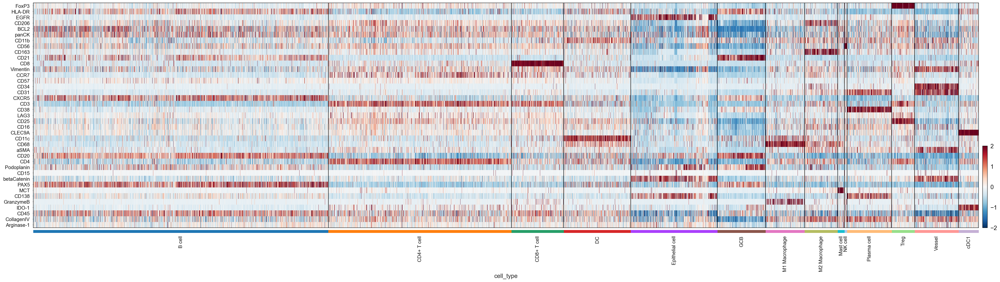

In [90]:
ax = sc.pl.heatmap(
    adata,
    marker_list,
    groupby="cell_type",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
    dendrogram=False,
    swap_axes=True,
    figsize=(40, 10),
)

In [91]:
# store the annotated adata
adata.write(output_dir + "adata_nn_demo_annotated.h5ad")

## Single-cell visualzation

In [94]:
# list of cell types
adata.obs['cell_type'].value_counts()

cell_type
B cell             15402
CD4+ T cell         9563
Epithelial cell     4522
DC                  3500
CD8+ T cell         2727
GCB                 2512
Plasma cell         2330
Vessel              2298
M1 Macrophage       2042
M2 Macrophage       1727
Treg                1195
cDC1                1048
Mast cell            354
NK cell              135
Name: count, dtype: int64

In [95]:
cell_type_colors = {
    'B cell' : '#1f77b4',           
    'CD4+ T cell' : '#ff7f0e',        
    'DC' : '#2ca02c',                
    'Vessel' : '#d62728',           
    'Epithelial cell' : '#9467bd',     
    'CD8+ T cell' : '#041f1e',     
    'GCB' : '#321325',               
    'Plasma cell' : '#5f0f40',      
    'M2 Macrophage' : '#bcbd22',     
    'Treg' : '#7f7f7f',            
    'cDC1' : '#17becf',             
    'M1 Macrophage' : '#e377c2',   
    'Mast cell' : '#f7dba7',          
    'NK cell' : '#000009',             
    'Neutrophil' : '#0ff4c6',           
    'PMN' : '#8c564b',                
}

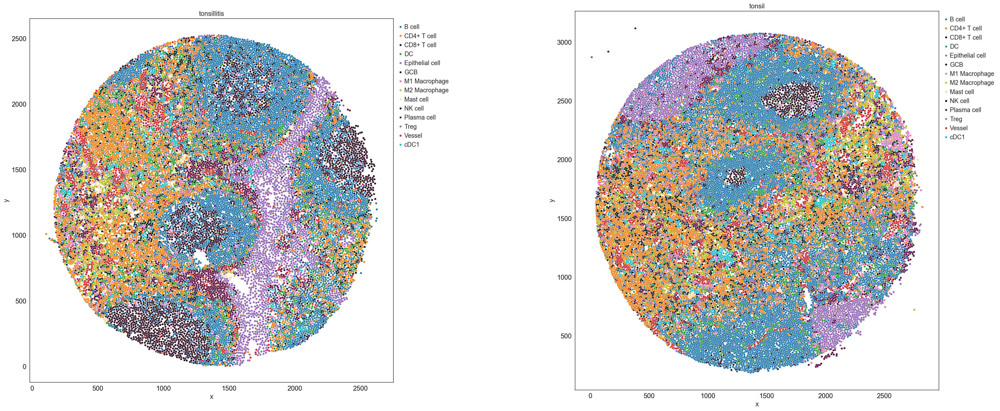

In [96]:
sp.pl.catplot(
    adata, 
    color = "cell_type", # specify group column name here (e.g. celltype_fine)
    unique_region = "condition", # specify unique_regions here
    X='x', Y='y', # specify x and y columns here
    n_columns=2, # adjust the number of columns for plotting here (how many plots do you want in one row?)
    palette=cell_type_colors, #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=False, # save figure as pdf
    output_fname = "", # change it to file name you prefer when saving the figure
    output_dir=output_dir, # specify output directory here (if savefig=True)
    figsize= 17,
    size = 20)

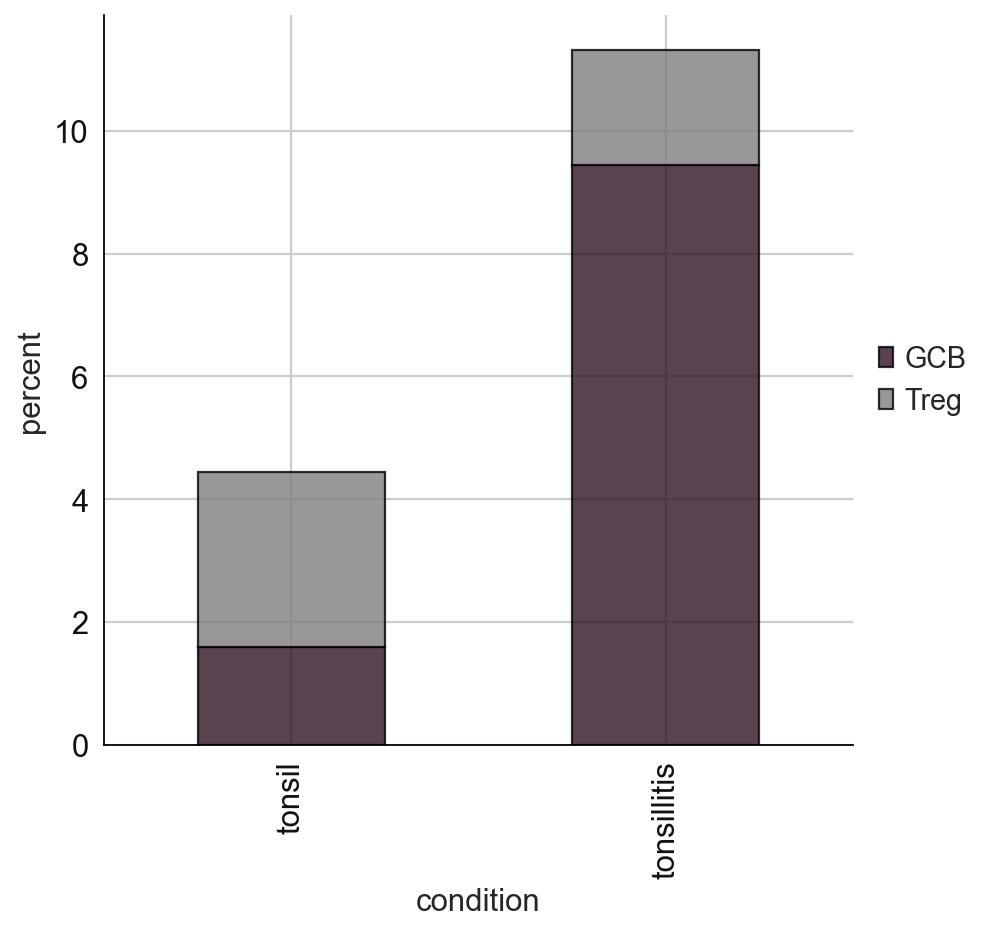

In [97]:
# cell type percentage tab and visualization [much few]
ct_perc_tab, _ = sp.pl.stacked_bar_plot(
    adata = adata, # adata object to use 
    color = 'cell_type', # column containing the categories that are used to fill the bar plot
    grouping = 'condition', # column containing a grouping variable (usually a condition or cell group) 
    cell_list = ['GCB', 'Treg'],  # list of cell types to plot, you can also see the entire cell types adata.obs['celltype_fine'].unique()
    palette=cell_type_colors, #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=False, # change it to true if you want to save the figure
    output_fname = "", # change it to file name you prefer when saving the figure
    output_dir = output_dir, #output directory for the figure
    norm = False, # if True, then whatever plotted will be scaled to sum of 1
    fig_sizing= (6,6)
)

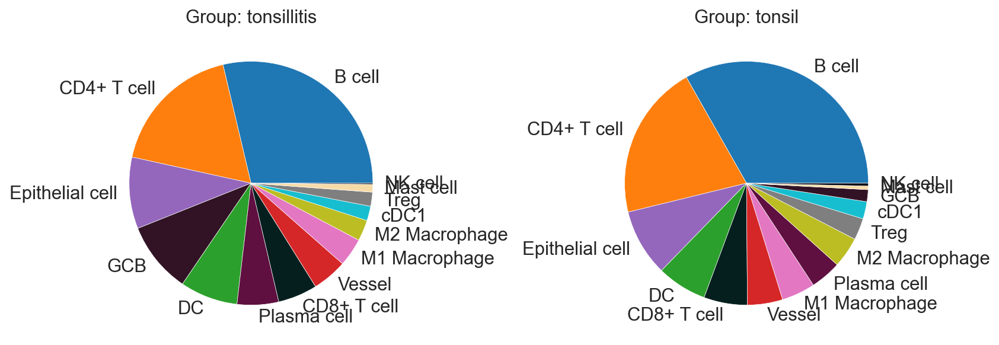

In [98]:
sp.pl.create_pie_charts(
    adata,
    color = "cell_type", 
    grouping = "condition", 
    show_percentages=False,
    palette=cell_type_colors, #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=False, # change it to true if you want to save the figure
    output_fname = "", # change it to file name you prefer when saving the figure
    output_dir = output_dir #output directory for the figure
)